<a href="https://colab.research.google.com/github/aruaru0/HuBmap/blob/main/SUB4_b5_train_segformer_ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SegFormer Train

In [1]:
!nvidia-smi

Tue Aug 23 04:42:15 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
%%capture
!pip install wandb --upgrade

In [3]:
import wandb
wandb.login()

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

## kaggle

In [4]:
!mkdir -p ~/.kaggle
!cp /content/drive/MyDrive/datas/kaggle.json  ~/.kaggle/

In [5]:
!chmod 600 /root/.kaggle/kaggle.json

In [6]:
!kaggle competitions download -c hubmap-organ-segmentation

100% 5.76G/5.78G [00:40<00:00, 166MB/s]
100% 5.78G/5.78G [00:40<00:00, 152MB/s]


In [7]:
# !mkdir hubmap
!unzip /content/hubmap-organ-segmentation.zip -d hubmap >/dev/null

In [8]:
!pip install pytorch-lightning
!pip install transformers datasets

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 705 kB 1.3 MB/s 
     |████████████████████████████████| 5.9 MB 24.6 MB/s 
     |████████████████████████████████| 419 kB 69.3 MB/s 
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.8.0
    Uninstalling tensorboard-2.8.0:
      Successfully uninstalled tensorboard-2.8.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.8.2+zzzcolab20220719082949 requires tensorboard<2.9,>=2.8, but you have tensorboard 2.10.0 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.7 MB 4.2 MB/s 
     |████████████████████████████████| 365 kB 71.4 MB/s 
     |████████████████████████████████| 

In [9]:
!pip install staintools
!pip install spams

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for staintools: filename=staintools-2.1.2-py3-none-any.whl size=14075 sha256=9f06eb2cd986950f8d8beac505225813ec3b39ee06c31cb8914708108c546b44
  Stored in directory: /root/.cache/pip/wheels/9b/ed/74/9d36d40854e911d8e2d2d28d7b67e37e9f176f913ecf34f813
Successfully built staintools
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.0 MB 3.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for spams: filename=spams-2.6.5.4-cp37-cp37m-linux_x86_64.whl size=3236581 sha256=5bef4e2879561b735897c45664a9536977a658db225158d724679472f7fd2f15
  Stored in directory: /root/.cache/pip/wheels/5e/92/17/e718e0e26bfcdd7e81afcf874ac2bc599dd7dd7f3ad78f9d76
Successfully built spams


In [10]:
# from google.colab import output
# output.enable_custom_widget_manager()

## Start code

In [1]:
import wandb
wandb.init(project="HuBMAP-SegFormer")

wandb: Currently logged in as: aruaru0. Use `wandb login --relogin` to force relogin


In [2]:
%load_ext tensorboard

In [3]:
from google.colab import output
output.enable_custom_widget_manager()

In [4]:
from torch.utils.tensorboard import SummaryWriter

In [5]:
from typing import Optional, List

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ConstantLR, LinearLR
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset
import torchvision.transforms as transforms
import pytorch_lightning as pl
from pytorch_lightning.callbacks import LearningRateMonitor, ModelCheckpoint

# from timm import create_model

import numpy as np
import cv2
import matplotlib.pyplot as plt

import os
import albumentations as albu
import random

import pandas as pd

from tqdm.notebook import tqdm

from sklearn.model_selection import KFold

In [6]:
#https://www.kaggle.com/code/pestipeti/decoding-rle-masks/notebook
def mask2rle(img):
    '''
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    '''
    pixels= img.T.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)


def rle2mask(mask_rle, shape=(3000,3000)):
    '''
    mask_rle: run-length as string formated (start length)
    shape: (width,height) of array to return 
    Returns numpy array, 1 - mask, 0 - background

    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0::2], s[1::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape).T

##  load test data

In [7]:
SEED = 43
BATCH_SIZE = 2
Gradient_Accumulation_Step = 14


In [8]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    #the following line gives ~10% speedup
    #but may lead to some stochasticity in the results 
    torch.backends.cudnn.benchmark = True
    
seed_everything(SEED)

In [9]:
DATA_DIR = './hubmap'
NFOLD = 5
FOLD = 0

WIDTH, HEIGHT = 768,768

model_path = '/content/drive/MyDrive/datas/HuBMAP/model-b5-fold{}.pth'.format(FOLD)
MODEL_NAME = "nvidia/mit-b5"
# MODEL_NAME = "nvidia/segformer-b3-finetuned-ade-512-512"

wandb.SEED = SEED
wandb.config.NFOLD = NFOLD
wandb.config.FOLD = FOLD
wandb.config.WIDTH = WIDTH
wandb.config.HEIGHT= HEIGHT
wandb.config.MODEL_NAME = MODEL_NAME

#
# nvidia/segformer-b0-finetuned-ade-512-512
# nvidia/segformer-b1-finetuned-ade-512-512
# nvidia/segformer-b2-finetuned-ade-512-512
# nvidia/segformer-b3-finetuned-ade-512-512
# nvidia/segformer-b4-finetuned-ade-512-512
# nvidia/segformer-b5-finetuned-ade-640-640
# https://huggingface.co/models?other=segformer&sort=downloads&search=nvidia%2Fsegformer+finetuned
#
df = pd.read_csv(DATA_DIR + '/train.csv')

In [10]:
df

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female
...,...,...,...,...,...,...,...,...,...,...
346,9517,kidney,HPA,3000,3000,0.4,4,1611763 11 1614753 29 1617750 35 1620746 43 16...,61.0,Male
347,9769,kidney,HPA,3070,3070,0.4,4,4030400 28 4033466 34 4036526 48 4039594 54 40...,28.0,Male
348,9777,largeintestine,HPA,3000,3000,0.4,4,538473 13 541468 22 544463 30 547461 35 550459...,84.0,Male
349,9791,kidney,HPA,3000,3000,0.4,4,334733 33 337729 43 340729 43 343725 51 346723...,28.0,Male


In [11]:
class2idx = dict([(name,i+1) for i, name in enumerate(df.organ.unique())])
class2idx['none'] = 0
idx2class = dict([(class2idx[name], name) for name in class2idx])
class2idx, idx2class

({'prostate': 1,
  'spleen': 2,
  'lung': 3,
  'kidney': 4,
  'largeintestine': 5,
  'none': 0},
 {1: 'prostate',
  2: 'spleen',
  3: 'lung',
  4: 'kidney',
  5: 'largeintestine',
  0: 'none'})

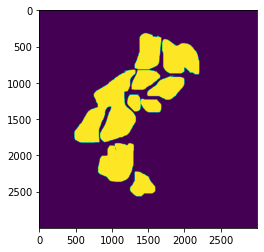

In [12]:
idx = 0
height, width, rle = df['img_height'][idx], df['img_width'][idx], df['rle'][idx]
mask = rle2mask(rle, shape=(height, width))
plt.imshow(mask)

In [13]:
from sklearn.model_selection import StratifiedKFold

df['fold'] = 0

skf = StratifiedKFold(n_splits=5)
for i, index in enumerate(skf.split(df.id, df.organ)):
  train_index, test_index = index
  # print("train_index:", train_index, "test_index:", test_index)
  # df['fold'][test_index] = i
  df.loc[test_index, 'fold'] = i

df

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex,fold
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male,0
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male,0
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male,0
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male,0
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female,0
...,...,...,...,...,...,...,...,...,...,...,...
346,9517,kidney,HPA,3000,3000,0.4,4,1611763 11 1614753 29 1617750 35 1620746 43 16...,61.0,Male,4
347,9769,kidney,HPA,3070,3070,0.4,4,4030400 28 4033466 34 4036526 48 4039594 54 40...,28.0,Male,4
348,9777,largeintestine,HPA,3000,3000,0.4,4,538473 13 541468 22 544463 30 547461 35 550459...,84.0,Male,4
349,9791,kidney,HPA,3000,3000,0.4,4,334733 33 337729 43 340729 43 343725 51 346723...,28.0,Male,4


## Utils

### augumentation

In [14]:
import staintools

In [15]:
class Stain(albu.ImageOnlyTransform):
    def __init__(
        self,
        method='vahadane', sigma1=0.2, sigma2=0.2,
        always_apply=False,
        p=0.5,
    ):
        super(Stain, self).__init__(always_apply, p)
        self.method = method
        self.sigma1 = sigma1
        self.sigma2 = sigma2
        self.augmentor = staintools.StainAugmentor(method=method, sigma1=sigma1, sigma2=sigma2)

    def apply(self, img, **params):
        self.augmentor.fit(img)
        return self.augmentor.pop().astype(int)

    def get_params(self):
        return {
        }

    def get_transform_init_args_names(self):
        return ("brightness_limit", "contrast_limit", "brightness_by_max")

In [16]:
# ----- set0
def get_training_augmentation_set0(p=0.5):
    return albu.Compose([
        albu.Sequential([
          albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
          albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
        ], p=p),
        albu.HorizontalFlip(p=p),
        albu.VerticalFlip(p=p),
        albu.RandomRotate90(p=p),
        albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
                         border_mode=cv2.BORDER_REFLECT),
        # albu.OneOf([
        #     albu.OpticalDistortion(p=1),
        #     albu.GridDistortion(p=1),
        #     albu.IAAPiecewiseAffine(p=1),
        # ], p=p),
        albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=p),
        albu.OneOf([
            albu.CLAHE(clip_limit=2, p = 1),
            albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
            albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        ], p=p),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
    ], p=p)
# ---- set1
def get_training_augmentation_set1(p=0.5):
    return albu.Compose([
        albu.Sequential([
          albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
          albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
        ], p=p),
        albu.HorizontalFlip(p=p),
        albu.VerticalFlip(p=p),
        albu.RandomRotate90(p=p),
        # albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
        #                  border_mode=cv2.BORDER_REFLECT),
        albu.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=15, p=p, 
                         border_mode=cv2.BORDER_REFLECT),
        # albu.OneOf([
        #     albu.OpticalDistortion(p=1),
        #     albu.GridDistortion(p=1),
        #     albu.IAAPiecewiseAffine(p=1),
        # ], p=p),
        albu.ChannelShuffle(p=p),
        albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=p),
        albu.OneOf([
            albu.CLAHE(clip_limit=2, p = 1),
            albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
            albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        ], p=p),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
    ], p=p)


In [17]:
def get_training_augmentation3(p=0.5):
    return albu.Compose([
        albu.Sequential([
          albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
          albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
        ], p=p),
        albu.HorizontalFlip(p=p),
        albu.VerticalFlip(p=p),
        albu.RandomRotate90(p=p),
        albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
                         border_mode=cv2.BORDER_REFLECT),
        # albu.OneOf([
        #     albu.OpticalDistortion(p=1),
        #     albu.GridDistortion(p=1),
        #     albu.IAAPiecewiseAffine(p=1),
        # ], p=p),
        albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=p),
        albu.OneOf([
            albu.CLAHE(clip_limit=2, p = 1),
            albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
            albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
        ], p=p),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
        albu.CoarseDropout (max_holes=50, max_height=16, max_width=16, p=p)
    ], p=p)

# def get_training_augmentation3(p=0.5):
#     return albu.Compose([
#         albu.Sequential([
#           albu.RandomScale(scale_limit=(-0.8, 0.0), interpolation=cv2.INTER_LINEAR, p=1),
#           albu.Resize(HEIGHT, WIDTH, interpolation=cv2.INTER_LINEAR, p=1)
#         ], p=p),
#         albu.HorizontalFlip(p=p),
#         albu.VerticalFlip(p=p),
#         albu.RandomRotate90(p=p),
#         albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=p, 
#                          border_mode=cv2.BORDER_REFLECT),
#         # albu.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=15, p=p, 
#         #                  border_mode=cv2.BORDER_REFLECT),
#         # albu.OneOf([
#         #     albu.OpticalDistortion(p=1),
#         #     albu.GridDistortion(p=1),
#         #     albu.IAAPiecewiseAffine(p=1),
#         # ], p=p),
#         albu.OneOf([
#             albu.ChannelShuffle(p=1),
#             albu.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=1),
#             albu.CLAHE(clip_limit=2, p = 1),
#             albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.2, p=1),
#             albu.HueSaturationValue (hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=1),
#         ], p=p),
#         albu.GaussNoise(var_limit=(10.0, 50.0), p=p),
#         albu.CoarseDropout (max_holes=50, max_height=16, max_width=16, p=p)
#     ], p=p)


In [18]:
def get_training_augmentation2(p=1.0):
    return albu.Compose([
        albu.HorizontalFlip(),
        albu.VerticalFlip(),
        albu.RandomRotate90(),
        albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=15, p=0.9, 
                         border_mode=cv2.BORDER_REFLECT),
        albu.OneOf([
            albu.OpticalDistortion(p=0.3),
            albu.GridDistortion(p=.1),
            albu.IAAPiecewiseAffine(p=0.3),
        ], p=0.3),
        albu.OneOf([
            # albu.HueSaturationValue(10,15,10),
            albu.CLAHE(clip_limit=2),
            albu.RandomBrightnessContrast(),            
        ], p=0.3),
        albu.GaussNoise(var_limit=(10.0, 50.0), p=0.3)
    ], p=p)

def get_training_augmentation():
    train_transform = [
        albu.PadIfNeeded(min_height=HEIGHT, min_width=WIDTH, always_apply=True, border_mode=0),
        albu.RandomCrop(height=HEIGHT, width=WIDTH, always_apply=True),
    ]
    return albu.Compose(train_transform)


def get_grayaug():
    train_transform = [
        albu.ToGray(p=1.0),
    ]
    return albu.Compose(train_transform)

# def get_validation_augmentation():
#     """画像のshapeが32で割り切れるようにPaddingするための関数"""
#     test_transform = [
#         albu.PadIfNeeded(384, 480)
#     ]
#     return albu.Compose(test_transform)

def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')

def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose    
    """
    
    _transform = [
        albu.Lambda(image=preprocessing_fn),
        albu.Lambda(image=to_tensor, mask=to_tensor),
    ]
    return albu.Compose(_transform)

# 可視化用の関数
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

## dataset

In [19]:
from transformers import SegformerFeatureExtractor

mean = np.array([0.7720342, 0.74582646, 0.76392896])
std = np.array([0.24745085, 0.26182273, 0.25782376])

def img2tensor(img,dtype:np.dtype=np.float32):
    if img.ndim==2 : img = np.expand_dims(img,2)
    img = np.transpose(img,(2,0,1))
    return torch.from_numpy(img.astype(dtype, copy=False))


# 1. torch.utils.data.Datasetを継承したDataset classを定義
class Dataset(torch.utils.data.Dataset):
    # CLASSES = ['sky', 'building', 'pole', 'road', 'pavement', 
    #            'tree', 'signsymbol', 'fence', 'car', 
    #            'pedestrian', 'bicyclist', 'unlabelled']
    
    def __init__(
            self,
            image_dir, 
            df, # ファイル名一覧
            # classes=None, # 推論対象のクラス
            augmentation=None, # augmentation用関数
            preprocessing=None, # 前処理用関数
            width = 768,
            height = 768,
    ):
        self.image_dir = image_dir
        self.df = df
        self.augmentation = augmentation
        self.preprocessing = preprocessing
        self.width = width
        self.height = height
        self.feature_extractor = SegformerFeatureExtractor(MODEL_NAME , reduce_labels=False, size=(width, height))
    
    # 3. 学習用データ(image)と特徴(mask)を返す__getitem__メソッドを作成
    def __getitem__(self, i):
        # データの読み込み
        fname = "{}/{}.tiff".format(self.image_dir,self.df['id'][i])
        # print(fname)
        image = cv2.imread(fname)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        rle, w, h = self.df['rle'][i], self.df['img_width'][i], self.df['img_height'][i]
        idx = class2idx[self.df['organ'][i]]
        mask = rle2mask(rle, shape = (w, h))
        # print(self.df['organ'][i], idx)

        image = cv2.resize(image, (self.width, self.height))
        mask = cv2.resize(mask, (self.width, self.height)) * idx

        # augmentation関数の適用
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # print("image", image.shape)
        # # return image, mask
        # image = (image/255 - mean)/std
        
        # return img2tensor(image),torch.tensor(mask), idx
        # return image, mask
        encoded_inputs = self.feature_extractor(image, mask, return_tensors="pt")

        for k,v in encoded_inputs.items():
          encoded_inputs[k].squeeze_() # remove batch dimension

        return encoded_inputs

    # 4. データセットの長さを返す__len__を作成
    def __len__(self):
        return len(self.df)

torch.Size([3, 768, 768])


tensor([0, 3])

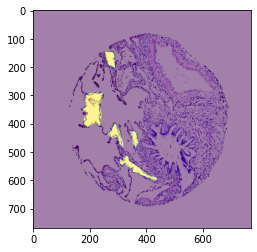

In [20]:
IMAGE_DIR = './hubmap/train_images'
train_dataset = Dataset(IMAGE_DIR, df[df['fold'] != FOLD].reset_index(), width=WIDTH, height=HEIGHT)
input = train_dataset[0]
print(input['pixel_values'].shape)
plt.imshow(input['pixel_values'].permute(1,2,0).numpy())
plt.imshow(input['labels'], alpha=0.5)
input['labels'].unique()

In [21]:
input

{'pixel_values': tensor([[[2.0434, 2.0605, 2.0434,  ..., 2.0605, 2.0434, 2.0434],
         [2.0605, 2.0434, 2.0605,  ..., 2.0605, 2.0605, 2.0434],
         [2.0434, 2.0605, 2.0434,  ..., 2.0434, 2.0434, 2.0434],
         ...,
         [2.0263, 2.0434, 2.0434,  ..., 2.0434, 2.0605, 2.0434],
         [2.0605, 2.0434, 2.0263,  ..., 2.0605, 2.0434, 2.0434],
         [2.0777, 2.0605, 2.0434,  ..., 2.0263, 2.0605, 2.0434]],

        [[2.2010, 2.2360, 2.2185,  ..., 2.2185, 2.2185, 2.2360],
         [2.2185, 2.2360, 2.2360,  ..., 2.2360, 2.2360, 2.2360],
         [2.2185, 2.2360, 2.2360,  ..., 2.2010, 2.2360, 2.2360],
         ...,
         [2.2185, 2.2360, 2.2360,  ..., 2.2360, 2.2185, 2.2010],
         [2.2185, 2.2185, 2.2010,  ..., 2.2360, 2.2360, 2.2185],
         [2.2010, 2.2185, 2.2360,  ..., 2.2010, 2.2185, 2.2185]],

        [[2.4483, 2.4308, 2.4308,  ..., 2.4483, 2.4308, 2.4308],
         [2.4308, 2.4308, 2.4483,  ..., 2.4483, 2.4483, 2.4308],
         [2.4483, 2.4483, 2.4308,  ..., 2

280
0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])
0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])
0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])
0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])


0 torch.Size([3, 768, 768])
0 torch.Size([3, 768, 768])


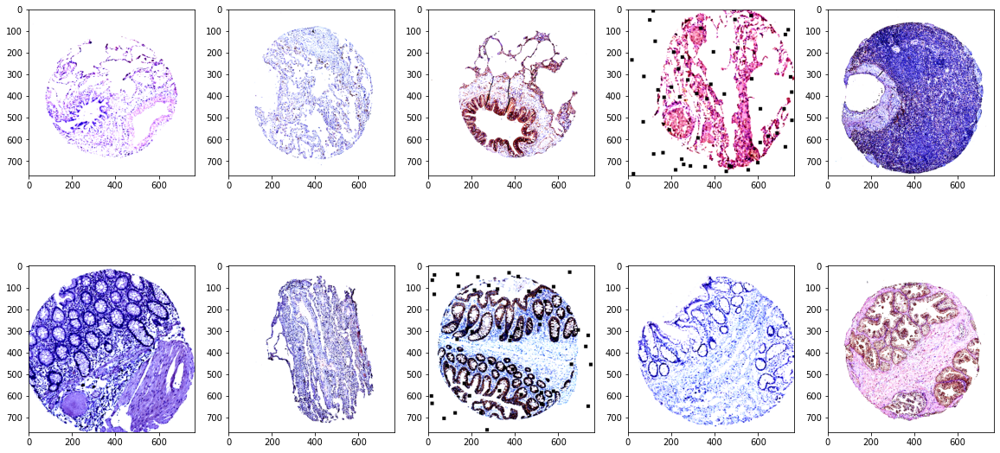

In [22]:
# # # データセットのインスタンスを作成
train_dataset = Dataset(IMAGE_DIR, df[df['fold'] != 0].reset_index(), 
                        width=WIDTH, height=HEIGHT,
                        augmentation=get_training_augmentation3(), 
                        )

plt.figure(figsize=(20, 10))

print(train_dataset.__len__())
for i in range(10) :
  input = train_dataset[i]
  print(idx, input.pixel_values.shape)
  plt.subplot(2, 5, i+1);
  plt.imshow(input['pixel_values'].permute(1,2,0).numpy())
  # plt.imshow(input['labels'], alpha=0.5)
plt.show()

In [23]:
from torch.utils.data import DataLoader
# CLASSES = ['car']


# データセットのインスタンスを作成
train_dataset = Dataset(IMAGE_DIR, df[df['fold'] != FOLD].reset_index(), 
                        width=WIDTH, height=HEIGHT,
                        augmentation=get_training_augmentation3(p=0.9), 
                        )

valid_dataset = Dataset(
    IMAGE_DIR, df[df['fold'] == FOLD].reset_index(), 
    width=WIDTH, height=HEIGHT,
    augmentation=None, 
)

# データローダーの作成
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

0


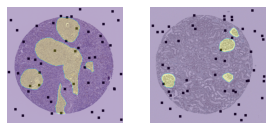

In [24]:
row, col = 8, 8
plt.figure(figsize=(20,20))

for inputs in train_loader:
  print(idx)
  data = inputs['pixel_values']
  mask = inputs['labels']
  for i in range(BATCH_SIZE) :
    plt.subplot(col, row, i+1)
    x = data[i].permute(1,2,0)
    plt.imshow((x-x.min())/(x.max()-x.min()))
    plt.imshow(mask[i], alpha=0.3)
    plt.axis('off')
  # print(data.shape)
  break

## ここまで前処理

In [25]:
from transformers import SegformerForSemanticSegmentation
# define model
model = SegformerForSemanticSegmentation.from_pretrained(MODEL_NAME,
                                                         num_labels=len(class2idx), 
                                                         id2label=idx2class, 
                                                         label2id=class2idx,
                                                         ignore_mismatched_sizes=True,
)

Some weights of the model checkpoint at nvidia/mit-b5 were not used when initializing SegformerForSemanticSegmentation: ['classifier.weight', 'classifier.bias']
- This IS expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing SegformerForSemanticSegmentation from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b5 and are newly initialized: ['decode_head.linear_c.1.proj.weight', 'decode_head.classifier.weight', 'decode_head.classifier.bias', 'decode_head.linear_c.1.proj.bias', 'decode_head.linear_c.3.proj.bias', 'decode_head.batch_norm.r

In [26]:
# model_path = '/content/drive/MyDrive/datas/HuBMAP/model.pth'
# model.load_state_dict(torch.load(model_path))

In [27]:
from datasets import load_metric

metric = load_metric("mean_iou")

In [28]:
test_df = df[df['fold'] == FOLD].reset_index()

def dice_coef(mask1, mask2):
    intersect = np.sum(mask1*mask2)
    sum1 = np.sum(mask1)
    sum2 = np.sum(mask2)
    dice = 2*intersect/(sum1+sum2)
    dice = np.mean(dice)
    return dice

def valid(model2) :
  model2.eval()
  dice = 0.0
  loss = 0.0
  for i in tqdm(range(len(test_df))) :
    id = test_df.id[i]
    fname = "/content/hubmap/train_images/{}.tiff".format(id)
    image = Image.open(fname)
    encoding = feature_extractor(image, return_tensors="pt")
    pixel_values = encoding.pixel_values.cuda()
    organ = test_df.organ[i]

    rle = test_df.rle[i]
    height, width = test_df.img_height[i], test_df.img_width[i]
    gt = rle2mask(rle, shape = (height, width))

    label = torch.tensor(gt).unsqueeze(0).long().cuda()
    # print(label.shape)

    idx = class2idx[organ]
    with torch.no_grad():
      outputs = model2(pixel_values=pixel_values, labels=label)
      loss += outputs.loss.item()
      # print(outputs.loss, loss)
      upsampled_logits = nn.functional.interpolate(outputs['logits'],
                  # size=image.size[::-1], # (height, width)
                  (height, width),
                  mode='bilinear',
                  align_corners=False)
      mask = upsampled_logits.argmax(dim=1)[0]
      mask[mask != idx] = 0
      mask[mask == idx] = 1


    dice += dice_coef(mask.cpu().numpy(), gt)
  return dice/len(test_df), loss/len(test_df)

In [29]:
# valid(model)

## TRAIN


In [30]:
import torch
from torch import nn
from sklearn.metrics import accuracy_score
# from tqdm.notebook import tqdm
# from tqdm import tqdm
from fastprogress.fastprogress import  progress_bar as tqdm

from PIL import Image
from transformers import SegformerFeatureExtractor

writer = SummaryWriter(log_dir="./logs")
feature_extractor = SegformerFeatureExtractor(reduce_labels=False, size=(WIDTH, HEIGHT))
use_amp = True # ampをオンオフ


# define optimizer
# optimizer = torch.optim.AdamW(model.parameters(), lr=0.00006)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4)#,  weight_decay=1e-4)
# move model to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

scaler = torch.cuda.amp.GradScaler(enabled=use_amp)

# scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, 
#                                               base_lr=1e-5,
#                                               max_lr=1e-3,
#                                               step_size_up=7,
#                                               step_size_down=13,
#                                               mode="triangular",
#                                               cycle_momentum=False,
#                                               gamma=0.95)

scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size = 10, gamma=1.0)

model.train()
cur_loss = 0
best_epoch = 0
for epoch in range(100):  # loop over the dataset multiple times
   print("Epoch:", epoch)
   
   model.train()
   optimizer.zero_grad()

   tot_loss = 0.0
   for idx, batch in enumerate(tqdm(train_loader)):
        # get the inputs;
        pixel_values = batch["pixel_values"].to(device)
        labels = batch["labels"].to(device)

        # print(pixel_values.shape, labels.shape)

        # zero the parameter gradients
        with torch.cuda.amp.autocast(enabled=use_amp):
            # forward + backward + optimize
            outputs = model(pixel_values=pixel_values, labels=labels)
            loss, logits = outputs.loss, outputs.logits

        tot_loss += loss.detach().cpu().numpy()
        
        scaler.scale(loss).backward()

        if (idx + 1) % Gradient_Accumulation_Step == 0 or idx == len(train_loader) :
            # optimizer.step()
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()

   scheduler.step()

   print("Loss:", tot_loss/len(train_loader))

   print("valid...")
   dice,valid_loss = valid(model)

   writer.add_scalars("loss", {
       "train": tot_loss/len(train_loader),
       "valid": valid_loss,
       }, epoch+1)  
   writer.add_scalar("lr", scheduler.get_last_lr()[0], epoch+1)
   
   wandb.log({'epoch': epoch, 'train_loss': tot_loss/len(train_loader), "valid_loss": valid_loss, 
              "dice": dice, "lr":scheduler.get_last_lr()[0], "best dice": cur_loss, "best epoch": best_epoch})
   if dice > cur_loss :
     cur_loss = dice
     best_epoch = epoch
     print("update best dice = ", dice, "loss = ", valid_loss)
     torch.save(model.state_dict(), model_path)
   else :
     print("epoch dice = ", dice, "loss = ", valid_loss)


writer.close()
wandb.save(model_path)


Epoch: 0


Loss: 1.6823293575218745
valid...


update best dice =  0.5236078062184685 loss =  1.1942550875771214
Epoch: 1


Loss: 0.8614471739956311
valid...


update best dice =  0.5953056001567921 loss =  0.7242380791986492
Epoch: 2


Loss: 0.5304684762443815
valid...


update best dice =  0.6324981910158223 loss =  0.6172589922035244
Epoch: 3


Loss: 0.38869557263595717
valid...


epoch dice =  0.612596183316073 loss =  0.4918228408820193
Epoch: 4


Loss: 0.30961875138538225
valid...


update best dice =  0.665337870266228 loss =  0.46716214559027847
Epoch: 5


Loss: 0.26089873611927034
valid...


update best dice =  0.6810747880218936 loss =  0.5038813100734227
Epoch: 6


Loss: 0.23984626877520765
valid...


update best dice =  0.6907689717045785 loss =  0.5038658301805107
Epoch: 7


Loss: 0.2106930379888841
valid...


update best dice =  0.6994997279022981 loss =  0.5011300762564364
Epoch: 8


Loss: 0.18888282871672085
valid...


epoch dice =  0.6897642448029316 loss =  0.47148910017920215
Epoch: 9


Loss: 0.17601359566407546
valid...


update best dice =  0.7068705439545374 loss =  0.5132268409074192
Epoch: 10


Loss: 0.1663193738354104
valid...


update best dice =  0.7130193878210861 loss =  0.48088615954342023
Epoch: 11


Loss: 0.14494913914906127
valid...


update best dice =  0.7163105938553128 loss =  0.5394738736811658
Epoch: 12


Loss: 0.1394312116184405
valid...


epoch dice =  0.701633701199137 loss =  0.548218740543849
Epoch: 13


Loss: 0.13515178007738932
valid...


update best dice =  0.7177859361949762 loss =  0.5444582870728533
Epoch: 14


Loss: 0.12145132036613566
valid...


update best dice =  0.7202890287635515 loss =  0.47040814250497753
Epoch: 15


Loss: 0.11625604704022408
valid...


epoch dice =  0.7154682225039121 loss =  0.5403554942196523
Epoch: 16


Loss: 0.11727335434406996
valid...


update best dice =  0.7219729527589466 loss =  0.5324559044355238
Epoch: 17


Loss: 0.11105640855218683
valid...


update best dice =  0.7267125793885267 loss =  0.535745452512318
Epoch: 18


Loss: 0.10652171006160123
valid...


epoch dice =  0.711016234016613 loss =  0.609609691609799
Epoch: 19


Loss: 0.10449582559189625
valid...


update best dice =  0.7270619694953957 loss =  0.552507682375505
Epoch: 20


Loss: 0.10342061820306948
valid...


epoch dice =  0.718957791326809 loss =  0.5844367961333671
Epoch: 21


Loss: 0.09857542015878218
valid...


update best dice =  0.7384833805251914 loss =  0.49459964813480917
Epoch: 22


Loss: 0.09748034152601447
valid...


epoch dice =  0.7309003597453513 loss =  0.5889799936451543
Epoch: 23


Loss: 0.0912721520688917
valid...


update best dice =  0.7439494871547271 loss =  0.5922655028251695
Epoch: 24


Loss: 0.09036327797387328
valid...


epoch dice =  0.7237309797699106 loss =  0.5920764199444946
Epoch: 25


Loss: 0.09083344944353615
valid...


update best dice =  0.7456375283951893 loss =  0.5708981152151672
Epoch: 26


Loss: 0.08940107738599182
valid...


epoch dice =  0.7241439521284027 loss =  0.5633024827275478
Epoch: 27


Loss: 0.08970090482117875
valid...


epoch dice =  0.738826095688406 loss =  0.5518450796289344
Epoch: 28


Loss: 0.0902780036974166
valid...


update best dice =  0.7534569015738468 loss =  0.5703584480978233
Epoch: 29


Loss: 0.08611301977985672
valid...


epoch dice =  0.7251602066150504 loss =  0.6002364128198422
Epoch: 30


Loss: 0.08555173985660076
valid...


epoch dice =  0.7280631893966084 loss =  0.5500521092662509
Epoch: 31


Loss: 0.08153170466955219
valid...


epoch dice =  0.7500684055809873 loss =  0.550724981064108
Epoch: 32


Loss: 0.0826554614651416
valid...


update best dice =  0.7647024334114435 loss =  0.5918199068433802
Epoch: 33


Loss: 0.07831279267556965
valid...


epoch dice =  0.7470153972732355 loss =  0.5903600461676087
Epoch: 34


Loss: 0.07738101485052279
valid...


update best dice =  0.7651900908152524 loss =  0.6135135133501509
Epoch: 35


Loss: 0.07493114259892276
valid...


epoch dice =  0.7430738614768592 loss =  0.5950822102456865
Epoch: 36


Loss: 0.07385777068058295
valid...


epoch dice =  0.7567891253412719 loss =  0.6407498383081295
Epoch: 37


Loss: 0.08548115215796445
valid...


epoch dice =  0.7505736089866883 loss =  0.6764727681875229
Epoch: 38


Loss: 0.07729992559179663
valid...


update best dice =  0.7681701059744124 loss =  0.6357066695329169
Epoch: 39


Loss: 0.07857410579121539
valid...


epoch dice =  0.7634974599963739 loss =  0.6427968202657263
Epoch: 40


Loss: 0.0758220836387149
valid...


epoch dice =  0.7510808704398625 loss =  0.6089530128093672
Epoch: 41


Loss: 0.07331675310353084
valid...


update best dice =  0.7695739556556346 loss =  0.6170215070982215
Epoch: 42


Loss: 0.06923613306134939
valid...


epoch dice =  0.7621926474303073 loss =  0.6111520294257453
Epoch: 43


Loss: 0.06801585328233029
valid...


epoch dice =  0.7600960902783402 loss =  0.6723811897698423
Epoch: 44


Loss: 0.06655639759264886
valid...


epoch dice =  0.7674326642210216 loss =  0.620884894485205
Epoch: 45


Loss: 0.06546848251351288
valid...


update best dice =  0.7724744215058241 loss =  0.6539693639259523
Epoch: 46


Loss: 0.07025600875328694
valid...


epoch dice =  0.7673058288919895 loss =  0.6653301853319289
Epoch: 47


Loss: 0.0667262043404792
valid...


epoch dice =  0.7531291227233979 loss =  0.6216837137307919
Epoch: 48


Loss: 0.06677364798129669
valid...


update best dice =  0.7820308614872042 loss =  0.6507964824182046
Epoch: 49


Loss: 0.06365884132018047
valid...


update best dice =  0.7822675994011052 loss =  0.6603940889291781
Epoch: 50


Loss: 0.06671418977369155
valid...


epoch dice =  0.7760133747801778 loss =  0.6663596879323603
Epoch: 51


Loss: 0.06589055861612515
valid...


epoch dice =  0.7713064440832946 loss =  0.7028822840624293
Epoch: 52


Loss: 0.06488658864317196
valid...


epoch dice =  0.7742528359766161 loss =  0.7008654248808891
Epoch: 53


Loss: 0.06116664968430996
valid...


epoch dice =  0.7787603348642008 loss =  0.6878705741706449
Epoch: 54


Loss: 0.060285956791735124
valid...


epoch dice =  0.777937166985984 loss =  0.669553969343993
Epoch: 55


Loss: 0.06058909055510802
valid...


epoch dice =  0.7647290887303724 loss =  0.6677988651405338
Epoch: 56


Loss: 0.0627430607032563
valid...


epoch dice =  0.7719424845782833 loss =  0.6214709204267448
Epoch: 57


Loss: 0.05872096567680793
valid...


epoch dice =  0.7677783366568175 loss =  0.6776169319965051
Epoch: 58


Loss: 0.058722360106185076
valid...


epoch dice =  0.780278649984611 loss =  0.7458275959787655
Epoch: 59


Loss: 0.05654665014839598
valid...


epoch dice =  0.7782744010784267 loss =  0.7035923537234186
Epoch: 60


Loss: 0.057946445097747656
valid...


epoch dice =  0.7773457208342924 loss =  0.7305415136293626
Epoch: 61


Loss: 0.055863228194149475
valid...


epoch dice =  0.7702896003435077 loss =  0.693658935981737
Epoch: 62


Loss: 0.05699570440753762
valid...


epoch dice =  0.7812931720661997 loss =  0.6995940062309235
Epoch: 63


Loss: 0.05400093869040055
valid...


epoch dice =  0.7663465651230954 loss =  0.6590994054740164
Epoch: 64


Loss: 0.05261247281118163
valid...


update best dice =  0.7826743790982609 loss =  0.6599353284535694
Epoch: 65


Loss: 0.05584585210308433
valid...


epoch dice =  0.7671534003603332 loss =  0.6982175374639706
Epoch: 66


Loss: 0.057474415257040945
valid...


epoch dice =  0.7739444514136025 loss =  0.7633086382083489
Epoch: 67


Loss: 0.058003365501229254
valid...


epoch dice =  0.7777576285726638 loss =  0.7000715109506543
Epoch: 68


Loss: 0.06017794604745826
valid...


epoch dice =  0.7779837118940178 loss =  0.73884090610688
Epoch: 69


Loss: 0.05486669006225254
valid...


epoch dice =  0.7666921646665346 loss =  0.6969117119803395
Epoch: 70


Loss: 0.05436121269927493
valid...


epoch dice =  0.7693207509776274 loss =  0.7051895770808341
Epoch: 71


Loss: 0.053887469394664676
valid...


epoch dice =  0.7685540984082335 loss =  0.6760990768671036
Epoch: 72


Loss: 0.05497530565064933
valid...


epoch dice =  0.7782876592732745 loss =  0.7236556882747043
Epoch: 73


Loss: 0.0519574484189174
valid...


epoch dice =  0.7705027611813107 loss =  0.7197904603844377
Epoch: 74


Loss: 0.0534403799401064
valid...


epoch dice =  0.7672861391746455 loss =  0.753376131273911
Epoch: 75


Loss: 0.04939809538690107
valid...


epoch dice =  0.7705919763552839 loss =  0.7131044907154331
Epoch: 76


Loss: 0.05131876092138035
valid...


epoch dice =  0.7592253836373398 loss =  0.7359074565358985
Epoch: 77


Loss: 0.05250673407821783
valid...


epoch dice =  0.7815882602600778 loss =  0.6847999583614964
Epoch: 78


Loss: 0.05353746480042381
valid...


epoch dice =  0.7570066114643267 loss =  0.7091259952687042
Epoch: 79


Loss: 0.052733334014192224
valid...


epoch dice =  0.7811190398706351 loss =  0.7122216362401214
Epoch: 80


Loss: 0.05069196548845087
valid...


epoch dice =  0.7755515562668367 loss =  0.7065674498887129
Epoch: 81


Loss: 0.050216728871289106
valid...


epoch dice =  0.7767059042424698 loss =  0.6750724738280118
Epoch: 82


Loss: 0.049662356647396724
valid...


epoch dice =  0.7776416439445604 loss =  0.7254351911620355
Epoch: 83


Loss: 0.04775027045980096
valid...


epoch dice =  0.7681359348306562 loss =  0.7362805420768933
Epoch: 84


Loss: 0.04865555535070598
valid...


epoch dice =  0.7755535880873253 loss =  0.7328923926491973
Epoch: 85


Loss: 0.048065936392439265
valid...


epoch dice =  0.7787911234800685 loss =  0.7831711105372704
Epoch: 86


Loss: 0.04875040925773127
valid...


epoch dice =  0.7737220394481866 loss =  0.7421651625297438
Epoch: 87


Loss: 0.04742914314182209
valid...


epoch dice =  0.7772928036365607 loss =  0.7780143286980373
Epoch: 88


Loss: 0.04753790098308985
valid...


epoch dice =  0.7761462715672981 loss =  0.7653775798602843
Epoch: 89


Loss: 0.04769345263817481
valid...


epoch dice =  0.7794431200057481 loss =  0.7429334117545628
Epoch: 90


Loss: 0.0489671163660075
valid...


epoch dice =  0.7780847008421133 loss =  0.7503013053620365
Epoch: 91


Loss: 0.045794733676926366
valid...


epoch dice =  0.7754289660636267 loss =  0.7729325712933927
Epoch: 92


Loss: 0.04544018537936998
valid...


epoch dice =  0.7808996769455688 loss =  0.7512659119101057
Epoch: 93


Loss: 0.044283130691785896
valid...


epoch dice =  0.7756067690740857 loss =  0.6727686309531121
Epoch: 94


Loss: 0.04827012344529586
valid...


epoch dice =  0.7697739514258564 loss =  0.7227118333250704
Epoch: 95


Loss: 0.0453886646112161
valid...


epoch dice =  0.7788347859977377 loss =  0.7535269625589881
Epoch: 96


Loss: 0.04663849955956851
valid...


epoch dice =  0.7763286129465474 loss =  0.7091735630283054
Epoch: 97


Loss: 0.04560653802140483
valid...


epoch dice =  0.779098899723348 loss =  0.7156607604152719
Epoch: 98


Loss: 0.04645767541868346
valid...


update best dice =  0.7827424381486142 loss =  0.7527968588376969
Epoch: 99


Loss: 0.046090614333349676
valid...


wandb: WARNING Saving files without folders. If you want to preserve sub directories pass base_path to wandb.save, i.e. wandb.save("/mnt/folder/file.h5", base_path="/mnt")


epoch dice =  0.773085829685617 loss =  0.7365401253681367


['/content/wandb/run-20220823_144911-2qtx7fru/files/model-b5-fold0.pth']

In [31]:
model_path_last = '/content/drive/MyDrive/datas/HuBMAP/last-fold{}.pth'.format(FOLD)
torch.save(model.state_dict(), model_path_last)

In [32]:
%tensorboard --logdir ./logs

<IPython.core.display.Javascript object>

In [33]:
# from transformers import SegformerForSemanticSegmentation
# # define model
# model = SegformerForSemanticSegmentation.from_pretrained("nvidia/mit-b3",
#                                                          num_labels=len(class2idx), 
#                                                          id2label=idx2class, 
#                                                          label2id=class2idx,
# )

In [34]:
# model2 = SegformerForSemanticSegmentation(model.config)
# model_path = '/content/drive/MyDrive/datas/HuBMAP/model.pth'
# model2.load_state_dict(torch.load(model_path))
# model2 = model2.cuda()

In [35]:
# from PIL import Image
# image = Image.open('/content/hubmap/train_images/10044.tiff')
# plt.imshow(image)

In [36]:
# from transformers import SegformerFeatureExtractor
# feature_extractor = SegformerFeatureExtractor(reduce_labels=False)

# encoding = feature_extractor(image, return_tensors="pt")
# pixel_values = encoding.pixel_values.cuda()
# print(pixel_values.shape)

In [37]:
# # forward pass
# outputs = model2(pixel_values=pixel_values)

In [38]:
# logits = outputs.logits.cpu()
# print(logits.shape)

In [39]:
# def ade_palette():
#     """ADE20K palette that maps each class to RGB values."""
#     return [[120, 120, 120], [180, 120, 120], [6, 230, 230], [80, 50, 50],
#             [4, 200, 3], [120, 120, 80], [140, 140, 140], [204, 5, 255]]

In [40]:
# from torch import nn
# import numpy as np
# import matplotlib.pyplot as plt

# # First, rescale logits to original image size
# upsampled_logits = nn.functional.interpolate(logits,
#                 size=image.size[::-1], # (height, width)
#                 mode='bilinear',
#                 align_corners=False)

# # Second, apply argmax on the class dimension
# seg = upsampled_logits.argmax(dim=1)[0]
# color_seg = np.zeros((seg.shape[0], seg.shape[1], 3), dtype=np.uint8) # height, width, 3
# palette = np.array(ade_palette())
# for label, color in enumerate(palette):
#     color_seg[seg == label, :] = color
# # Convert to BGR
# color_seg = color_seg[..., ::-1]

# # Show image + mask
# img = np.array(image) * 0.5 + color_seg * 0.5
# img = img.astype(np.uint8)

# plt.figure(figsize=(15, 10))
# plt.imshow(img)
# plt.show()

# inference

In [41]:
def dice_coef(mask1, mask2):
    intersect = np.sum(mask1*mask2)
    sum1 = np.sum(mask1)
    sum2 = np.sum(mask2)
    dice = 2*intersect/(sum1+sum2)
    dice = np.mean(dice)
    return dice


In [42]:
from transformers import SegformerForSemanticSegmentation
from transformers import SegformerModel, SegformerConfig

# define model
# model = SegformerForSemanticSegmentation.from_pretrained(MODEL_NAME,
#                                                          num_labels=len(class2idx), 
#                                                          id2label=idx2class, 
#                                                          label2id=class2idx,
# )


config = SegformerConfig.from_pretrained(MODEL_NAME,
                        num_labels=len(class2idx), 
                        id2label=idx2class, 
                        label2id=class2idx,
                        ignore_mismatched_sizes=True,
)

model2 = SegformerForSemanticSegmentation(config)
# model_path = '/content/drive/MyDrive/datas/HuBMAP/model-sub3-fold{}.pth'.format(FOLD)
model2.load_state_dict(torch.load(model_path))
model2 = model2.cuda()

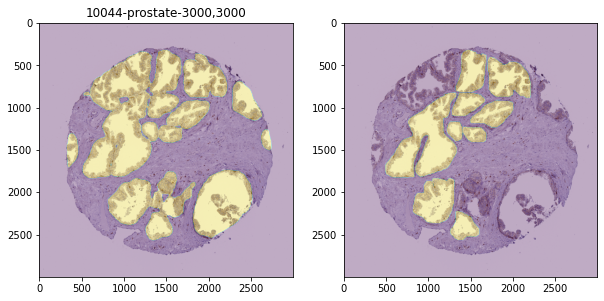

0.6786393963745119 0.6786393963745119


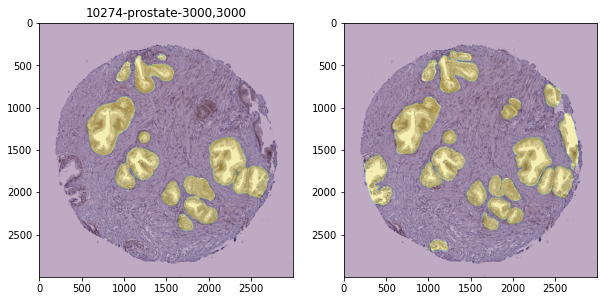

0.8207558674688032 0.7496976319216575


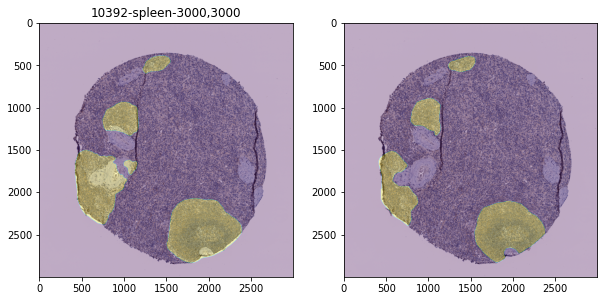

0.8345520477769367 0.7779824372067505


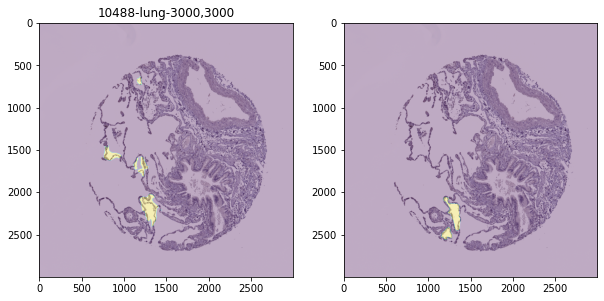

0.40951322583327665 0.685865134363382


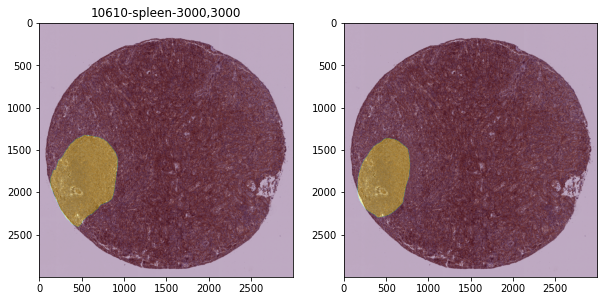

0.840579766034287 0.7168080606975631


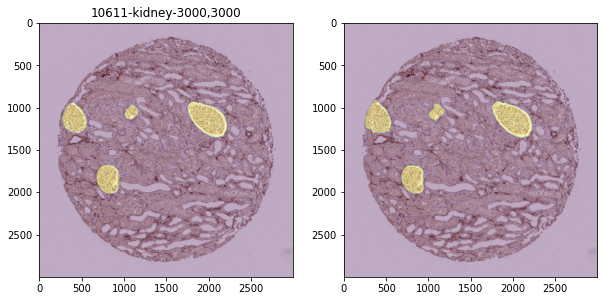

0.9492749236048931 0.7555525378487847


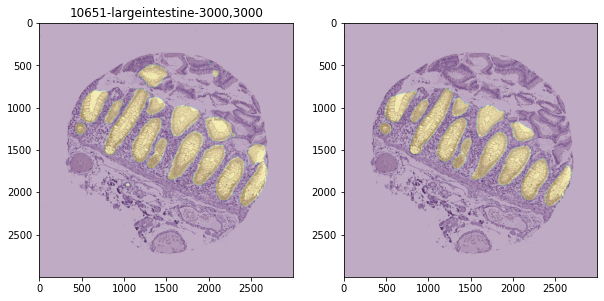

0.881582629212946 0.7735568366150934


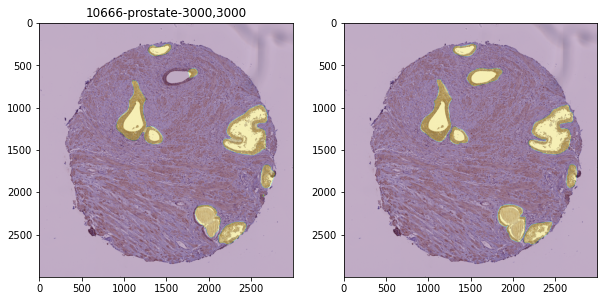

0.8888906317030265 0.7879735610010851


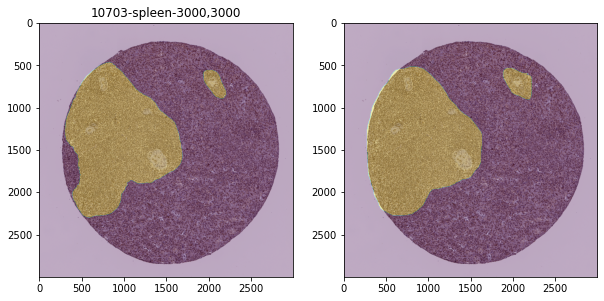

0.9276938696805371 0.8034980397432464


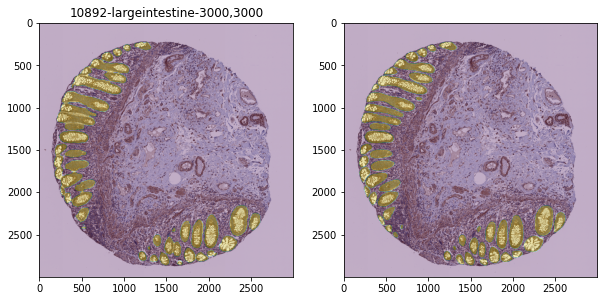

0.9126076627630739 0.814409002045229


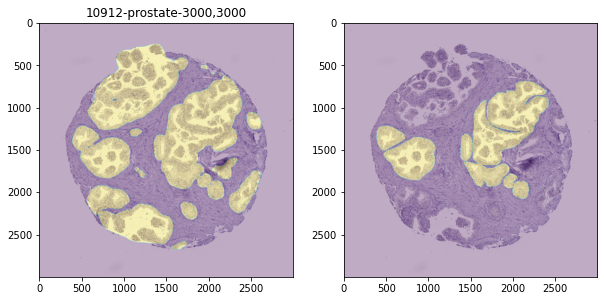

0.5718092221853812 0.7923544766034247


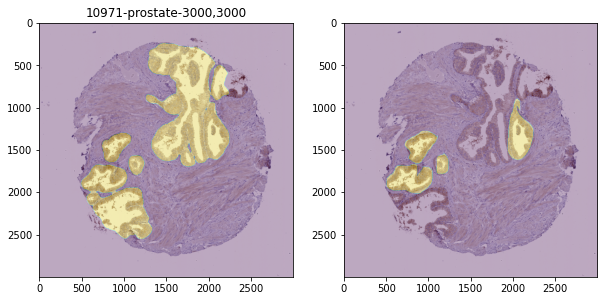

0.38160668682726384 0.758125494122078


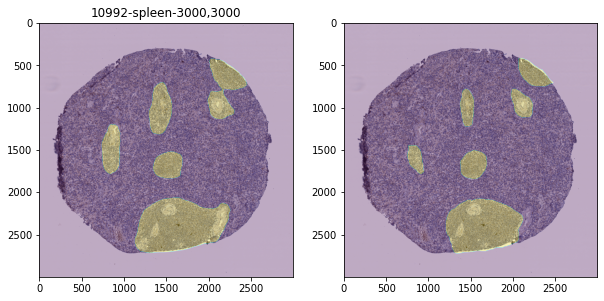

0.837515961090635 0.7642324531196591


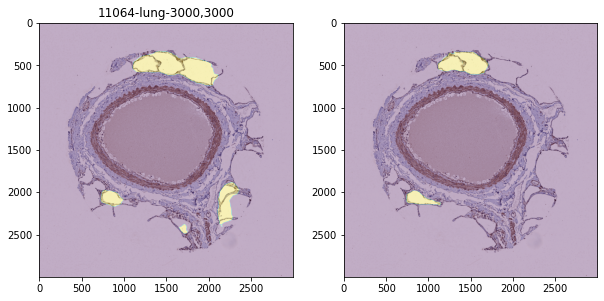

0.5758973973399604 0.7507799491353949


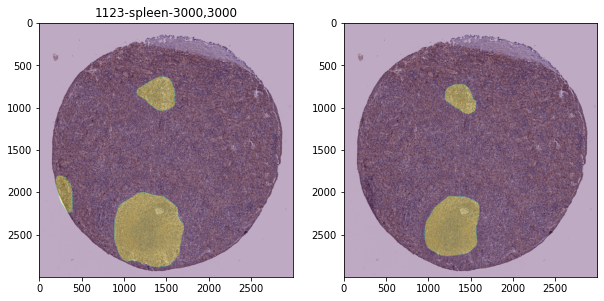

0.7338249869535141 0.7496496183232696


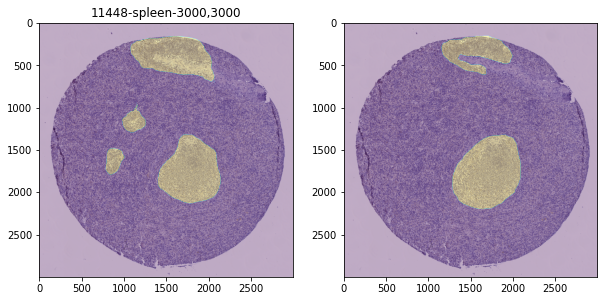

0.7424227644038832 0.749197939953308


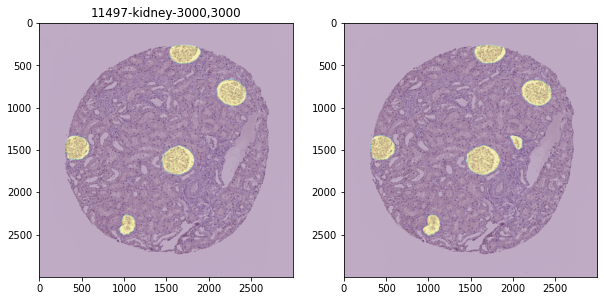

0.9509830622243863 0.7610676530280773


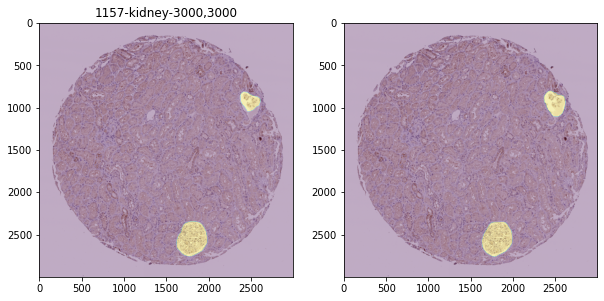

0.9270787030273264 0.7702904891391467


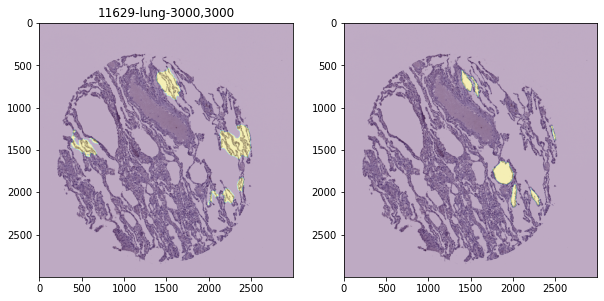

0.22175053065301537 0.7414199650082977


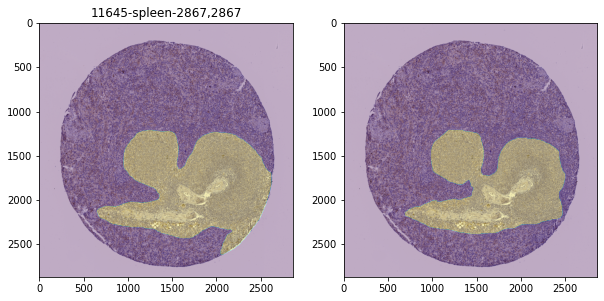

0.8919503203454735 0.7489464827751565


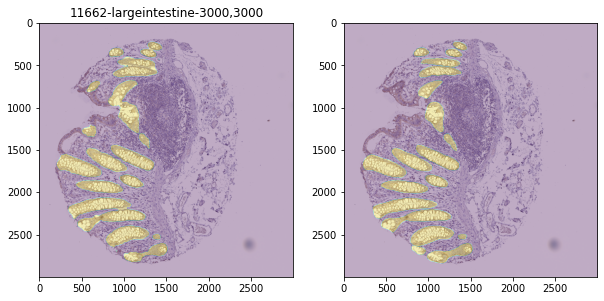

0.9144328142741108 0.7568267842751067


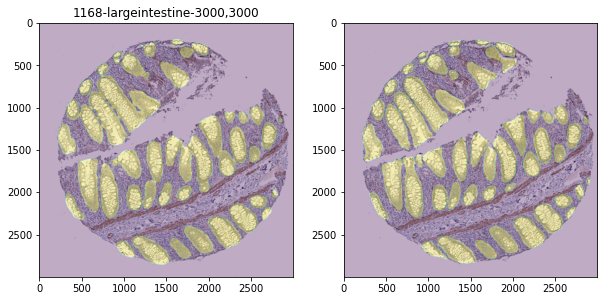

0.9166134907181318 0.7640898163861533


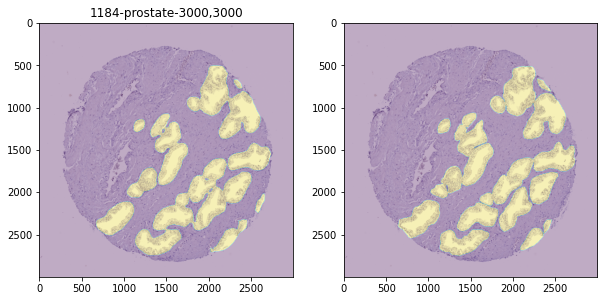

0.9232061844842795 0.7710079193469414


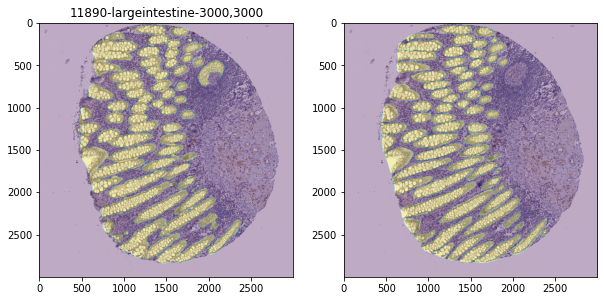

0.8957986153146937 0.776207531678931


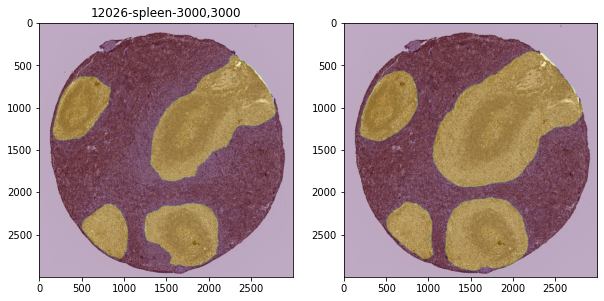

0.8338530755113536 0.7785133534322278


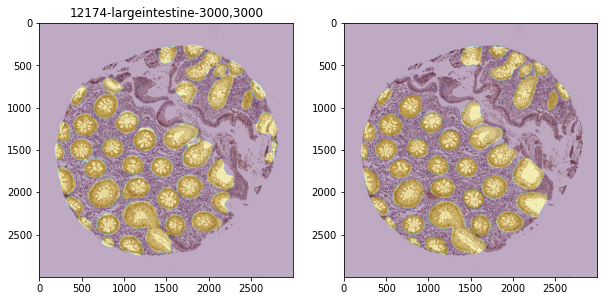

0.8701175061236615 0.7820365900742061


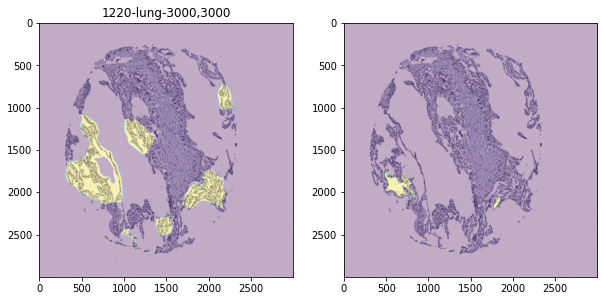

0.17628225179723092 0.759601244212096


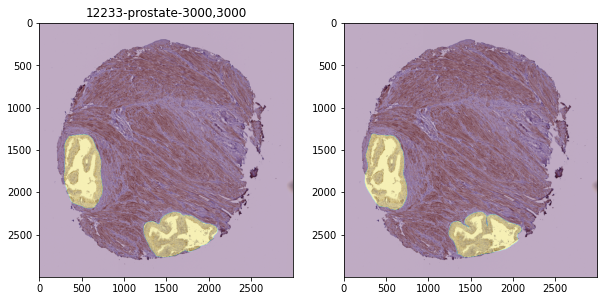

0.949107750946462 0.7663693337383233


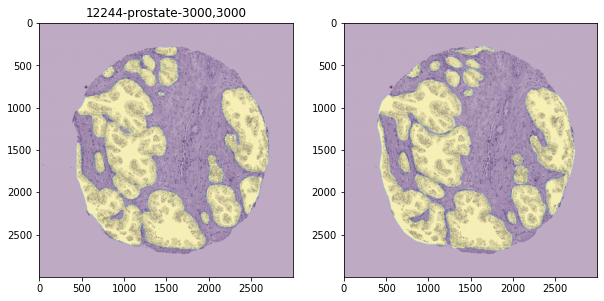

0.9227360453685106 0.771761289311778


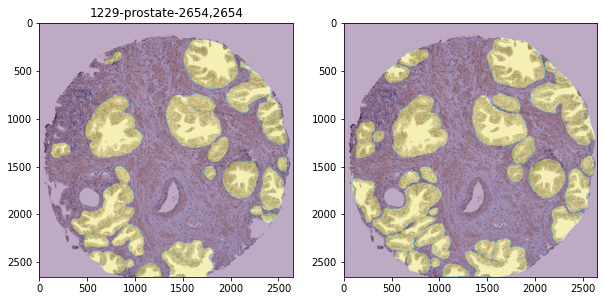

0.8624043315333696 0.7747827240524977


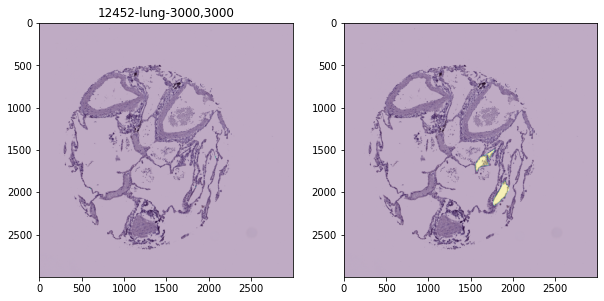

0.00012976901116013495 0.7497939190511642


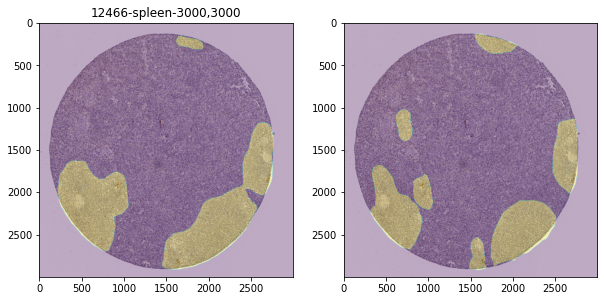

0.8266857992909498 0.7521967903086575


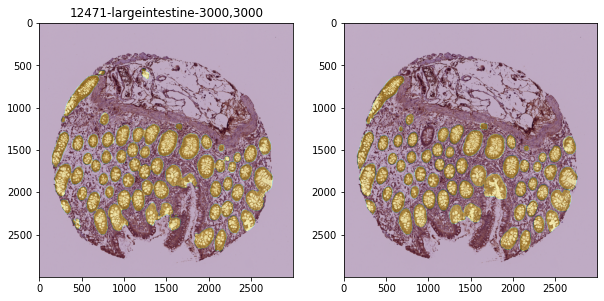

0.8967262532329341 0.7565764710033326


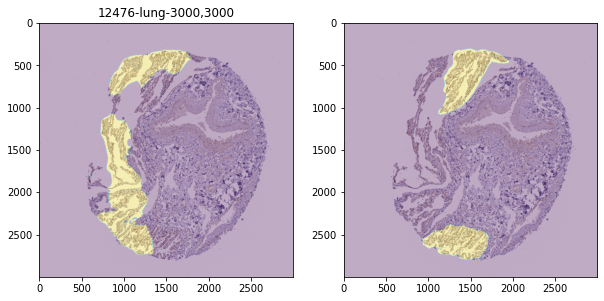

0.33783560653503963 0.7442605632248533


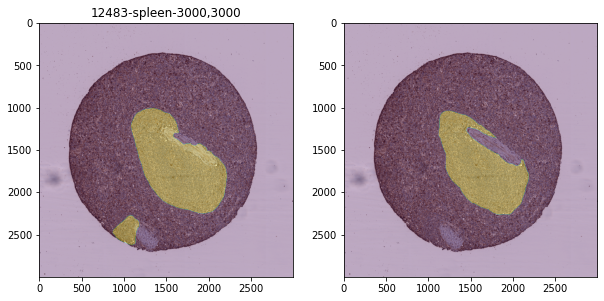

0.8576335385271069 0.747499791090632


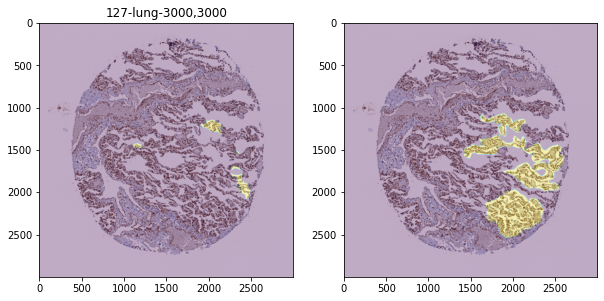

0.11702266549508065 0.7299865376018668


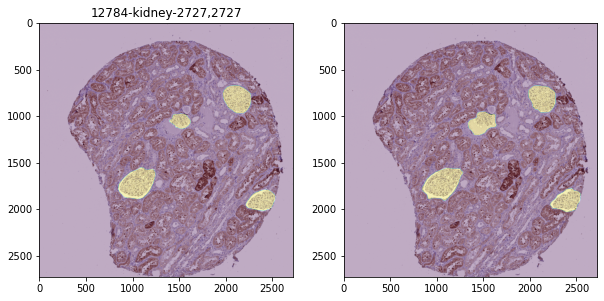

0.9140875833319076 0.7349622415405166


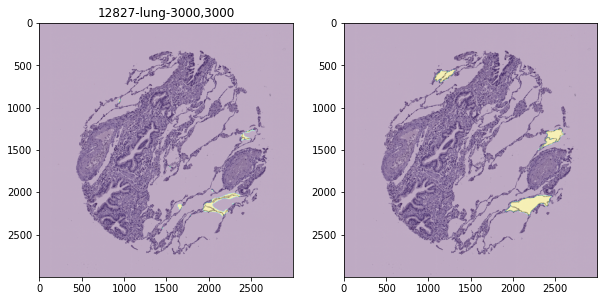

0.3575235080062814 0.7250296432896156


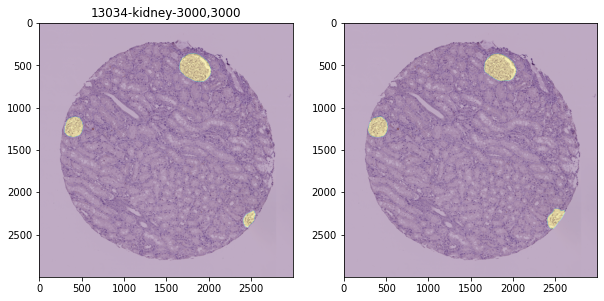

0.9347572971453808 0.7304072754397635


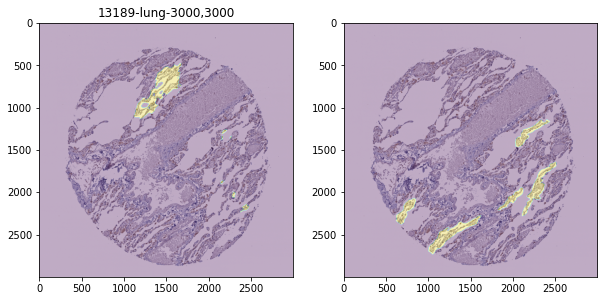

0.02705690612142556 0.7128235162068051


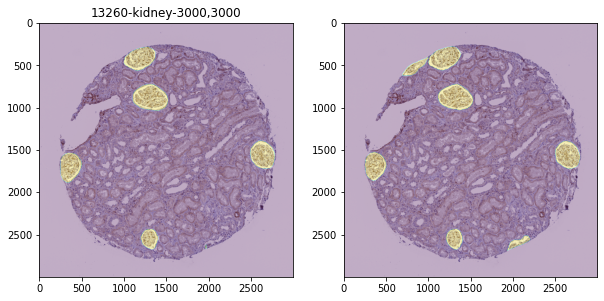

0.9070708840330424 0.7175612568854938


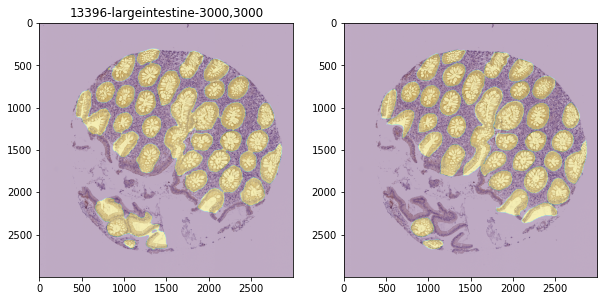

0.8873799838844769 0.7216045599092791


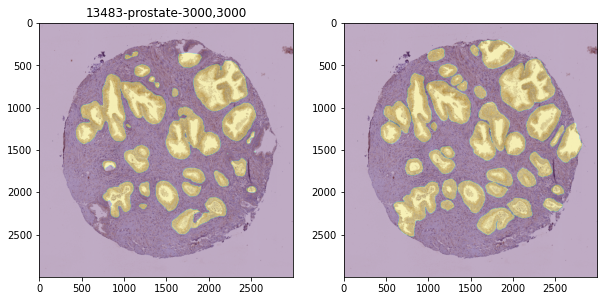

0.835771635749284 0.7242596081846281


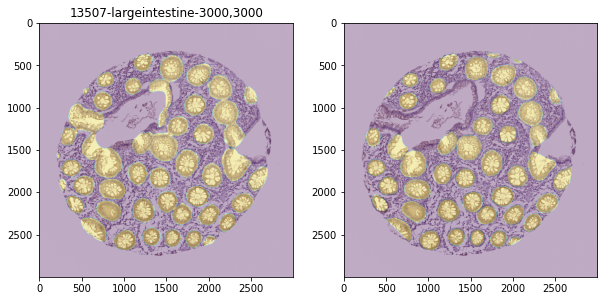

0.881511749678029 0.7278335204912962


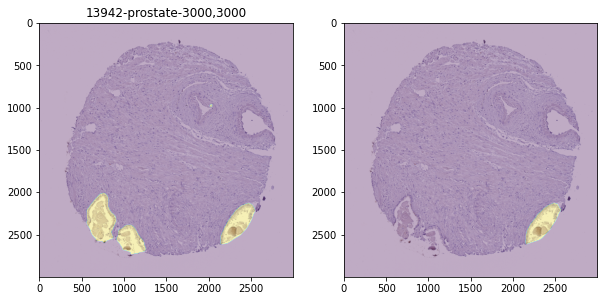

0.4702851765933462 0.7221102239602306


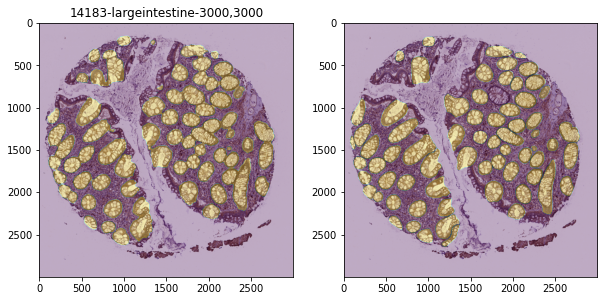

0.8995071474179205 0.7259666788180065


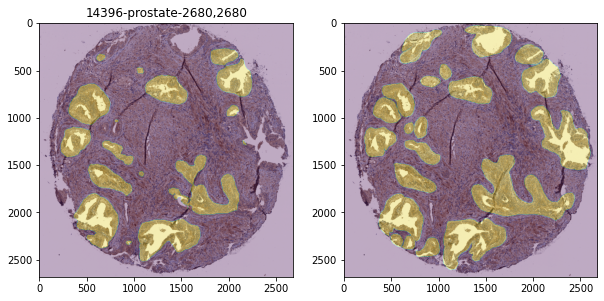

0.7235292828844434 0.7259148193300583


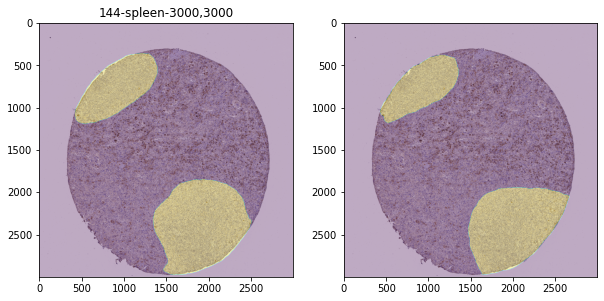

0.8918757857271139 0.7293723394633304


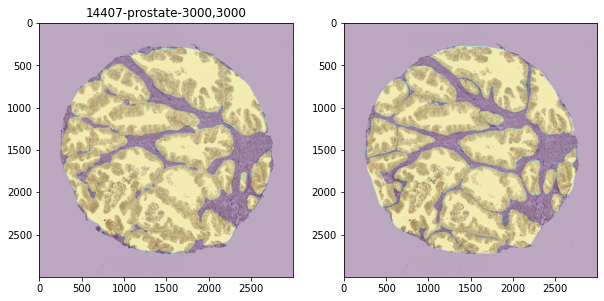

0.9445719230632996 0.7337641677000644


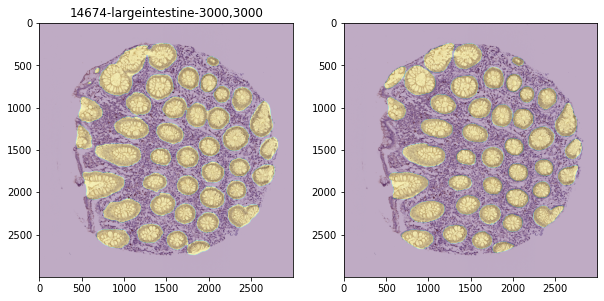

0.9020272342974184 0.7371294290320115


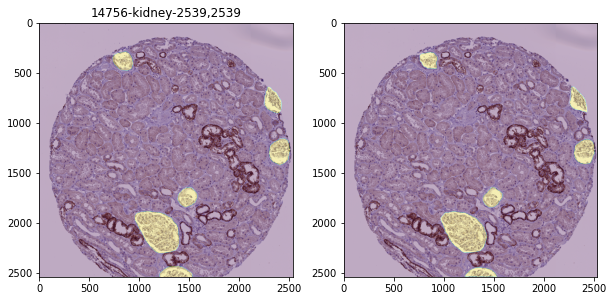

0.9409879071733905 0.7411266540936072


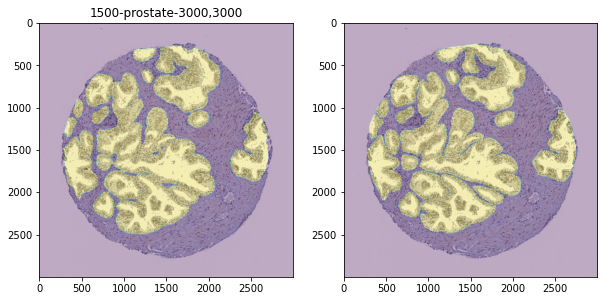

0.9501856426489949 0.745147019258134


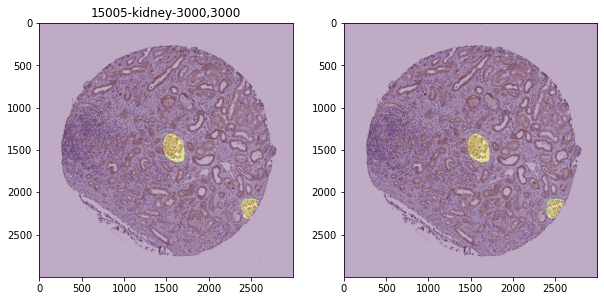

0.9639322015248697 0.7492750415650535


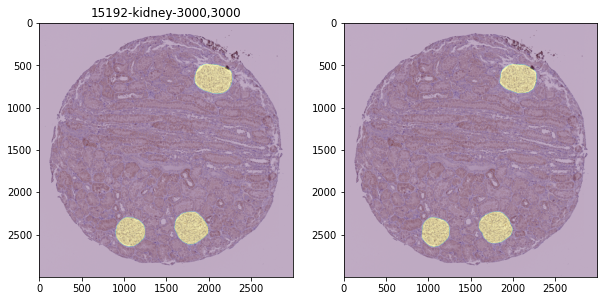

0.9719273839742489 0.7533982330911497


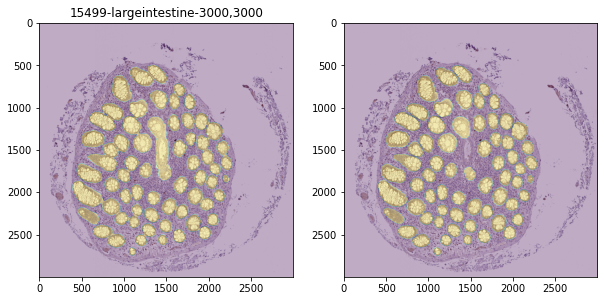

0.9437696108703759 0.7568595308689539


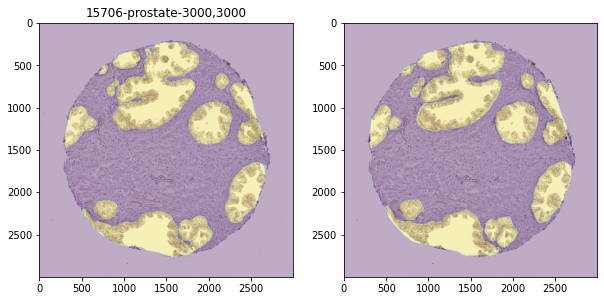

0.9480119102393157 0.7602729662148532


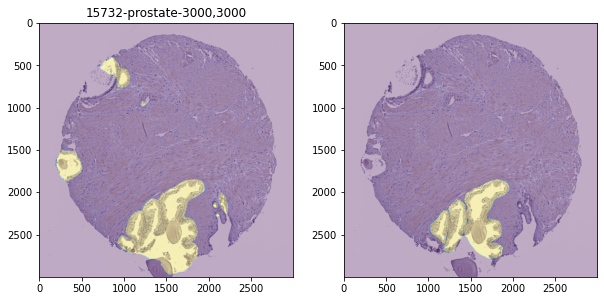

0.7254190921769205 0.7596614947405035


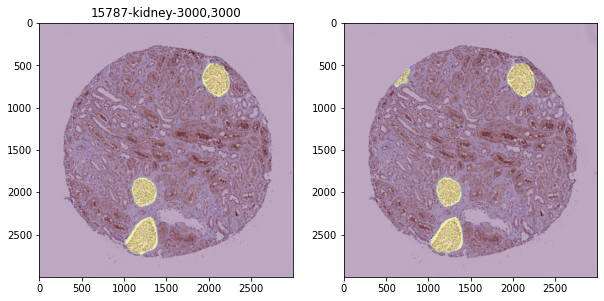

0.9420150036299104 0.7628055207558381


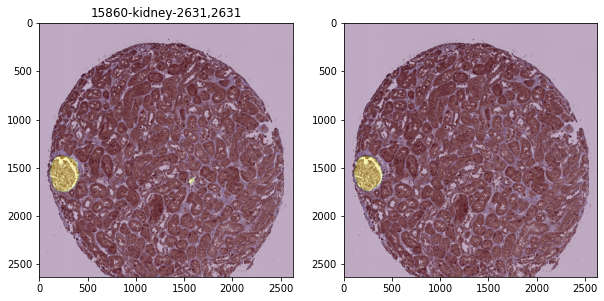

0.914721044793218 0.7653803601463022


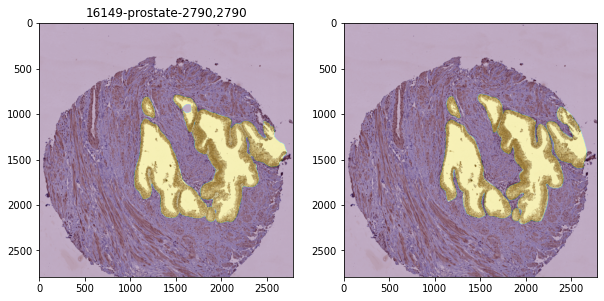

0.9412561737304335 0.7683116237060376


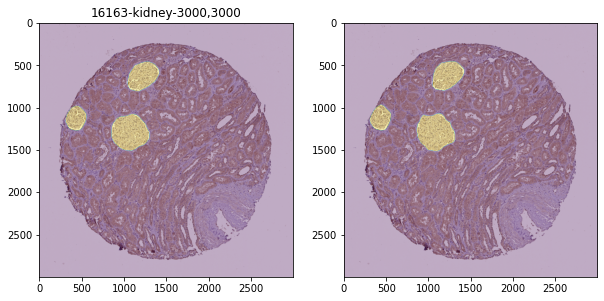

0.9637930689303089 0.7715162375621731


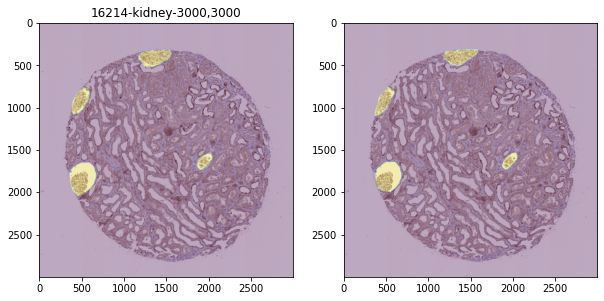

0.9021020253038666 0.7736224599451037


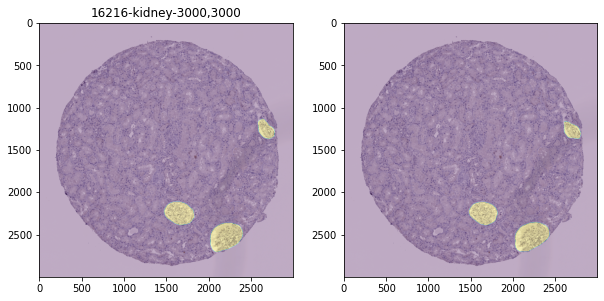

0.9490596160209452 0.7764071767082124


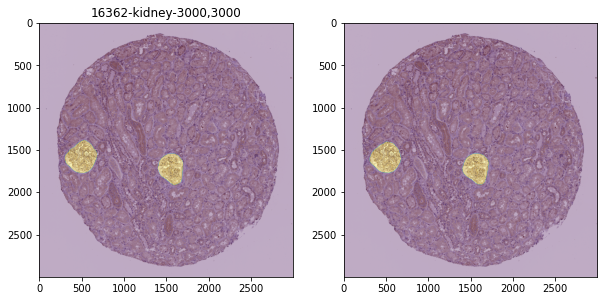

0.9663517780768257 0.779375061104597


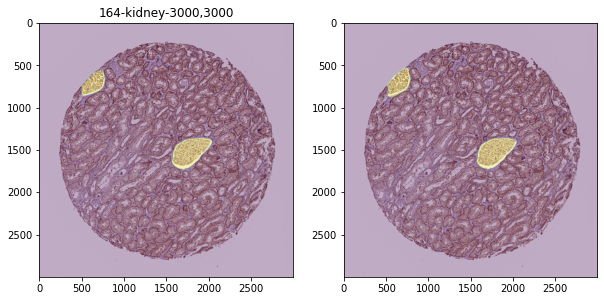

0.9490866985091909 0.78198600937236


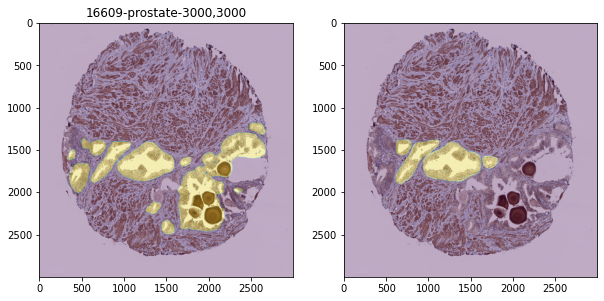

0.469614340974192 0.777253105305721


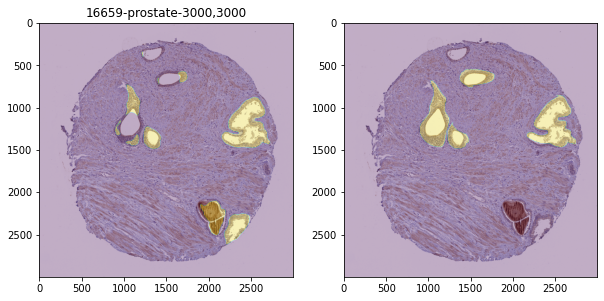

0.6302459599617951 0.7750589688080505


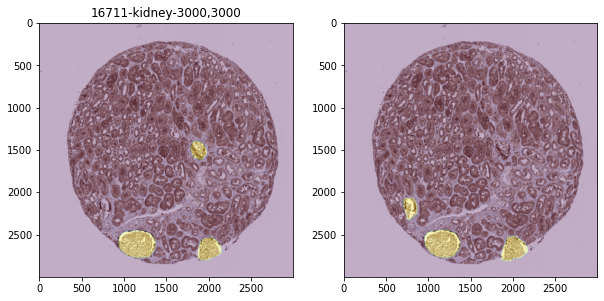

0.79964899798411 0.775420586884169


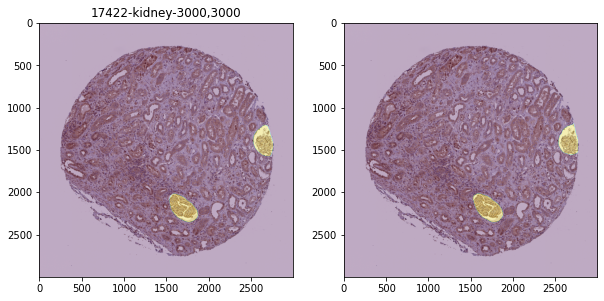

0.9561277442283594 0.7780395311935051


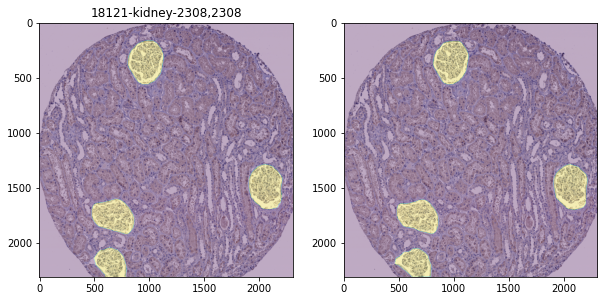

0.9760025359690657 0.7808675741188703


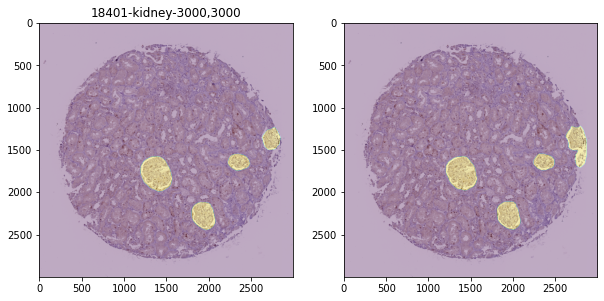

0.9139829202306923 0.7827424381486142
DICE =  0.7827424381486142


In [43]:
from PIL import Image
from transformers import SegformerFeatureExtractor
feature_extractor = SegformerFeatureExtractor(reduce_labels=False, size=(WIDTH, HEIGHT))

# print(pixel_values.shape)
# image = Image.open('/content/hubmap/train_images/10651.tiff')
# plt.imshow(image)

model2.eval()
dice = 0.0

test_df = df[df['fold'] == FOLD].reset_index()
for i in range(len(test_df)) :
  id = test_df.id[i]
  fname = "/content/hubmap/train_images/{}.tiff".format(id)
  image = Image.open(fname)
  encoding = feature_extractor(image, return_tensors="pt")
  pixel_values = encoding.pixel_values.cuda()
  organ = test_df.organ[i]
  rle = test_df.rle[i]
  height, width = test_df.img_height[i], test_df.img_width[i]
  idx = class2idx[organ]
  with torch.no_grad():
    outputs = model2(pixel_values=pixel_values)
    upsampled_logits = nn.functional.interpolate(outputs['logits'],
                # size=image.size[::-1], # (height, width)
                (height, width),
                mode='bilinear',
                align_corners=False)
    mask = upsampled_logits.argmax(dim=1)[0]
    mask[mask != idx] = 0
    mask[mask == idx] = 1

  gt = rle2mask(rle, shape = (height, width))
  plt.figure(figsize=(10,10))
  plt.subplot(1, 2, 1)
  plt.imshow(image)
  plt.imshow(mask.cpu().numpy(), alpha=0.3)
  plt.title("{}-{}-{},{}".format(id, organ, width, height))
  plt.subplot(1, 2, 2)
  plt.imshow(image)
  plt.imshow(gt, alpha=0.3)
  plt.show()

  dice += dice_coef(mask.cpu().numpy(), gt)
  print(dice_coef(mask.cpu().numpy(), gt), dice/(i+1))

print("DICE = ", dice/len(test_df))

In [44]:
len(test_df)

71

In [45]:
def calc_resize(w, p) :
    a = 3000/512
    target = int((w*p/0.4)/a + 0.5)
    target = (target+31)//32 * 32
    return target

calc_resize(2023, 0.4945), calc_resize(3000, 0.4), calc_resize(160, 6.263), calc_resize(4500, 0.2290)

(448, 512, 448, 448)

In [46]:
!pip install staintools
!pip install spams

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [47]:
# 多くのカグラーは染色ツールを使用して、増強のために組織画像の色を着色しています。
# 彼らは他のより重要な側面を見逃しています：テクスチャ（すなわち形態）
import staintools

# Read data
to_augment = staintools.read_image("/content/hubmap/train_images/10044.tiff")

# Standardize brightness (optional, can improve the tissue mask calculation)
# to_augment = staintools.LuminosityStandardizer.standardize(to_augment)

# Stain augment
augmentor = staintools.StainAugmentor(method='vahadane', sigma1=0.2, sigma2=0.2)

augmentor.fit(to_augment)
augmented_images = []
for _ in range(2):
    augmented_image = augmentor.pop()
    augmented_images.append(augmented_image)

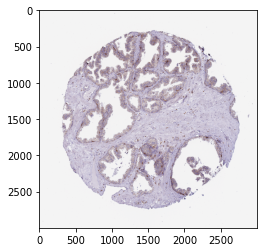

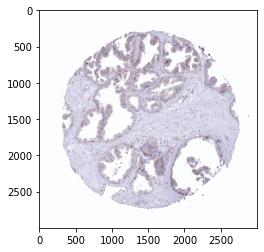

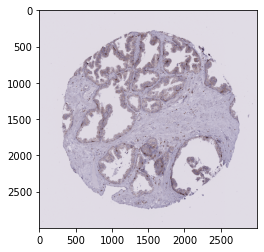

In [48]:
import matplotlib.pyplot as plt
plt.imshow(to_augment)
plt.show()
for e in augmented_images:
  plt.imshow(e/255)
  plt.show()